In [1]:
import numpy as np
import pandas as pd
import plotly.express as px
import get_data as gd

In [2]:
# bike_df = pd.read_parquet('Data/bike_data_10-19.parquet')
# reading in data direct from aws bucket
# create urls for all the years required
urls = [
    gd.get_url(year)
    for year in gd.years
]
# generator with dataframe objects (lazy execution)
# generator is not really useful for this notebook as we will read in all dataframes
# and not analyze by reading in one at a time but still better to use than list comprehension
dfs = (
    gd.get_bike_data(url, is_folder=False)
    for url in urls
)

bike_df = pd.DataFrame()

for year_df in dfs:
    bike_df = pd.concat([bike_df, year_df])
    
bike_df.head()

,Duration,Start_date,End_date,Start station number,Start_station,End station number,End_station,Bike number,Member type
0,1012,2010-09-20 11:27:04,2010-09-20 11:43:56,31208,M St & New Jersey Ave SE,31108,4th & M St SW,W00742,Member
1,61,2010-09-20 11:41:22,2010-09-20 11:42:23,31209,1st & N St SE,31209,1st & N St SE,W00032,Member
2,2690,2010-09-20 12:05:37,2010-09-20 12:50:27,31600,5th & K St NW,31100,19th St & Pennsylvania Ave NW,W00993,Member
3,1406,2010-09-20 12:06:05,2010-09-20 12:29:32,31600,5th & K St NW,31602,Park Rd & Holmead Pl NW,W00344,Member
4,1413,2010-09-20 12:10:43,2010-09-20 12:34:17,31100,19th St & Pennsylvania Ave NW,31201,15th & P St NW,W00883,Member


### In diesem Beispiel werden wir verschiedene Modelle fur eine Station trainieren und für diese eine Station Vorhersagen machen.

- Features: Zeitreihe mit Feiertagen und/ oder Wetterdaten
- Vorhergsage: Auslastung -> Anzahl Rentals pro Stunde oder pro Tag
- Traindaten: 2010-2017
- Testdaten: 2018, 2019
- Validierungsdaten: 2020-2022

In [3]:
# selecting only one station for testing models
union_station = bike_df[
    (bike_df['Start_station'] == 'Columbus Circle / Union Station') |
    (bike_df['End_station'] == 'Columbus Circle / Union Station')
].copy(deep=True)

In [4]:
# delete complete dataset, which is no longer required
del bike_df

In [5]:
union_station.head()

,Duration,Start_date,End_date,Start station number,Start_station,End station number,End_station,Bike number,Member type
30311,828,2010-10-26 11:47:25,2010-10-26 12:01:14,31623,Columbus Circle / Union Station,31227,13th St & New York Ave NW,W00813,Casual
30329,120,2010-10-26 12:16:44,2010-10-26 12:18:44,31623,Columbus Circle / Union Station,31616,3rd & H St NE,W00563,Member
30446,126,2010-10-26 14:06:09,2010-10-26 14:08:15,31616,3rd & H St NE,31623,Columbus Circle / Union Station,W00892,Member
30459,627,2010-10-26 14:20:33,2010-10-26 14:31:01,31223,Convention Center / 7th & M St NW,31623,Columbus Circle / Union Station,W00727,Member
30541,491,2010-10-26 15:30:02,2010-10-26 15:38:14,31623,Columbus Circle / Union Station,31611,13th & H St NE,W00636,Member


In [6]:
# Dauer der Fahrt in Minuten
union_station['minutes'] = union_station['Duration']/60

In [7]:
union_station[
    (union_station['Start_station'] == 'Columbus Circle / Union Station') &
    (union_station['End_station'] == 'Columbus Circle / Union Station') &
    (union_station['minutes'] < 5)
]

,Duration,Start_date,End_date,Start station number,Start_station,End station number,End_station,Bike number,Member type,minutes
36784,200,2010-10-30 14:18:15,2010-10-30 14:21:36,31623,Columbus Circle / Union Station,31623,Columbus Circle / Union Station,W00581,Member,3.333333
36805,167,2010-10-30 14:22:54,2010-10-30 14:25:41,31623,Columbus Circle / Union Station,31623,Columbus Circle / Union Station,W00446,Member,2.783333
55263,77,2010-11-10 20:12:12,2010-11-10 20:13:29,31623,Columbus Circle / Union Station,31623,Columbus Circle / Union Station,W01015,Member,1.283333
69893,289,2010-11-18 19:14:16,2010-11-18 19:19:05,31623,Columbus Circle / Union Station,31623,Columbus Circle / Union Station,W00968,Member,4.816667
74361,122,2010-11-20 21:30:28,2010-11-20 21:32:31,31623,Columbus Circle / Union Station,31623,Columbus Circle / Union Station,W00814,Member,2.033333
...,...,...,...,...,...,...,...,...,...,...
124156,170,2019-12-22 17:19:52,2019-12-22 17:22:43,31623,Columbus Circle / Union Station,31623,Columbus Circle / Union Station,W24679,Member,2.833333
146662,82,2019-12-28 15:12:10,2019-12-28 15:13:33,31623,Columbus Circle / Union Station,31623,Columbus Circle / Union Station,W23708,Member,1.366667
146669,61,2019-12-28 15:12:26,2019-12-28 15:13:27,31623,Columbus Circle / Union Station,31623,Columbus Circle / Union Station,W24003,Member,1.016667
148801,232,2019-12-28 19:39:41,2019-12-28 19:43:33,31623,Columbus Circle / Union Station,31623,Columbus Circle / Union Station,W01090,Casual,3.866667


In [8]:
# Wenn die Fahrt an der Station endet
incomings = union_station[
    (union_station['End_station'] == 'Columbus Circle / Union Station') &
    (union_station['minutes'] >= 5)
]
# Wenn die Fahrt von der Station beginnt
outgoings = union_station[
    (union_station['Start_station'] == 'Columbus Circle / Union Station') &
    (union_station['minutes'] >= 5)
]

In [9]:
incomings.dtypes

Duration                         int64
Start_date              datetime64[ns]
End_date                datetime64[ns]
Start station number             int64
Start_station                   object
End station number               int64
End_station                     object
Bike number                     object
Member type                     object
minutes                        float64
dtype: object

In [10]:
incomings = incomings.groupby(pd.Grouper(key='Start_date', freq='h')).agg(
    {
        'Bike number': 'count',
    }
)
outgoings = outgoings.groupby(pd.Grouper(key='Start_date', freq='h')).agg(
    {
        'Bike number': 'count',
    }
)

In [11]:
outgoings.rename(columns={
    'Bike number': 'rentals_in_hour'
}, inplace=True)

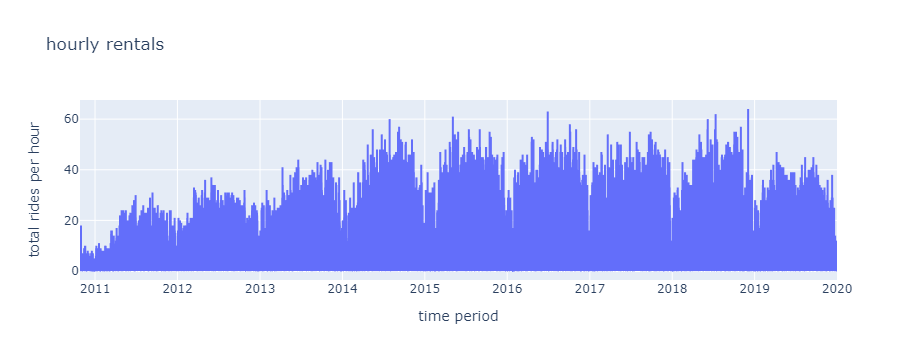

In [12]:
px.line(x=outgoings.index, y=outgoings.rentals_in_hour,
       title='hourly rentals', labels={
           'x': 'time period',
           'y': 'total rides per hour'
       })

In [13]:
import itertools
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import statsmodels.api as sm
import matplotlib
import pmdarima as pm

In [14]:
from statsmodels.tsa.stattools import adfuller

In [15]:
def adf_test(timeseries):
    #Perform Dickey-Fuller test:
    print('Results of Dickey-Fuller Test:')
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=[
        'Test Statistic','p-value','#Lags Used','Number of Observations Used'
    ])
    for key,value in dftest[4].items():
       dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)

In [16]:
outgoings.fillna(method='ffill', inplace=True)

In [17]:
outgoings['rentals_in_hour']

Start_date
2010-10-26 11:00:00    1
2010-10-26 12:00:00    0
2010-10-26 13:00:00    0
2010-10-26 14:00:00    0
2010-10-26 15:00:00    2
                      ..
2019-12-31 18:00:00    1
2019-12-31 19:00:00    1
2019-12-31 20:00:00    1
2019-12-31 21:00:00    0
2019-12-31 22:00:00    2
Freq: H, Name: rentals_in_hour, Length: 80484, dtype: int64

### Test ob die Zeitreihe Stationär ist oder nicht

In [18]:
output = adf_test(outgoings['rentals_in_hour'])
output

Results of Dickey-Fuller Test:
Test Statistic                   -26.101537
p-value                            0.000000
#Lags Used                        64.000000
Number of Observations Used    80419.000000
Critical Value (1%)               -3.430431
Critical Value (5%)               -2.861576
Critical Value (10%)              -2.566789
dtype: float64


In [19]:
output_2 =  adf_test(outgoings.loc[:'2014', 'rentals_in_hour'])
output_2

Results of Dickey-Fuller Test:
Test Statistic                -1.445240e+01
p-value                        7.062948e-27
#Lags Used                     5.200000e+01
Number of Observations Used    3.660800e+04
Critical Value (1%)           -3.430529e+00
Critical Value (5%)           -2.861619e+00
Critical Value (10%)          -2.566812e+00
dtype: float64


### Komponente der Zeitreihe (Trend, Saisonal)

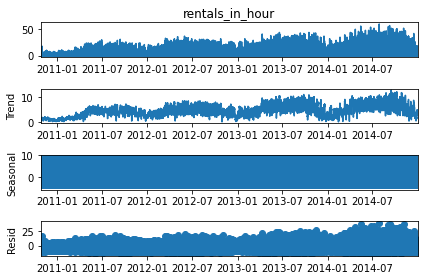

In [20]:
from pylab import rcParams
rcParams['figure.figsize'] = (18, 8)
decomposition = sm.tsa.seasonal_decompose(outgoings.loc[:'2014', 'rentals_in_hour'], model='additive')
fig = decomposition.plot()
plt.show()

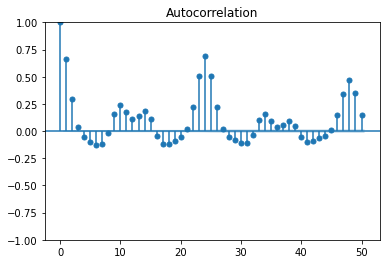

C:\Users\Admin\anaconda3\envs\forecasting_env\lib\site-packages\statsmodels\graphics\tsaplots.py:348: FutureWarning:

The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.



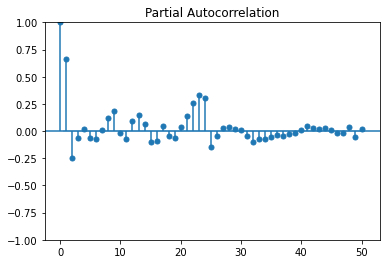

In [21]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
plot_acf(outgoings['rentals_in_hour'])
matplotlib.pyplot.show()
plot_pacf(outgoings['rentals_in_hour'])
matplotlib.pyplot.show()

In [22]:
train_data = outgoings[:'2017'].copy()
train_data

,rentals_in_hour
Start_date,
2010-10-26 11:00:00,1
2010-10-26 12:00:00,0
2010-10-26 13:00:00,0
2010-10-26 14:00:00,0
2010-10-26 15:00:00,2
...,...
2017-12-31 19:00:00,0
2017-12-31 20:00:00,0
2017-12-31 21:00:00,0


In [23]:
# outgoings = outgoings.reset_index()
# outgoings.columns = ['ds', 'y']
# outgoings.set_index('ds')
test_data = outgoings['2018':].copy()
test_data

,rentals_in_hour
Start_date,
2018-01-01 00:00:00,0
2018-01-01 01:00:00,1
2018-01-01 02:00:00,0
2018-01-01 03:00:00,0
2018-01-01 04:00:00,0
...,...
2019-12-31 18:00:00,1
2019-12-31 19:00:00,1
2019-12-31 20:00:00,1


In [24]:
test_data = test_data[['rentals_in_hour']]
test_data = test_data.reset_index()
test_data.columns = ['ds', 'y']
train_data = train_data[['rentals_in_hour']]
train_data = train_data.reset_index()
train_data.columns = ['ds', 'y']

In [25]:
from prophet import Prophet

C:\Users\Admin\anaconda3\envs\forecasting_env\lib\site-packages\tqdm\auto.py:22: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html



In [26]:
m = Prophet(changepoint_prior_scale=0.12)
m.add_country_holidays(country_name='US')
m.fit(train_data)

C:\Users\Admin\anaconda3\envs\forecasting_env\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [27]:
test_data.shape

(17519, 2)

In [28]:
periods = test_data.shape[0]

C:\Users\Admin\anaconda3\envs\forecasting_env\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\Admin\anaconda3\envs\forecasting_env\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



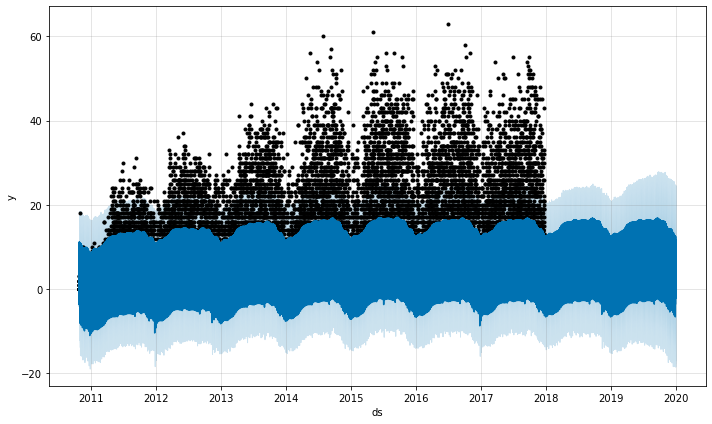

In [29]:
future = m.make_future_dataframe(periods=periods, freq='H')
fcast = m.predict(future)
fig = m.plot(fcast)

C:\Users\Admin\anaconda3\envs\forecasting_env\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\Admin\anaconda3\envs\forecasting_env\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\Admin\anaconda3\envs\forecasting_env\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



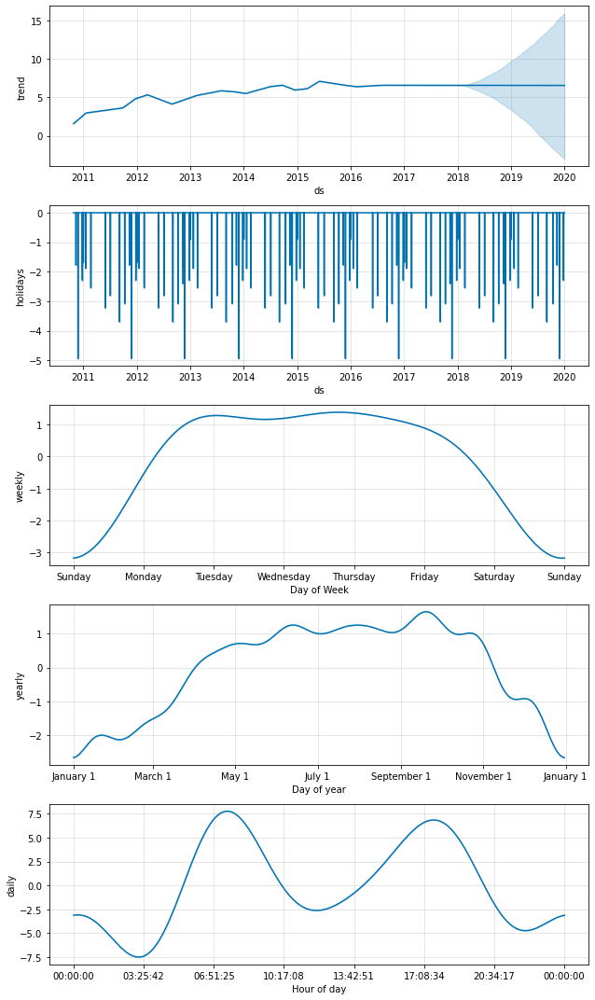

In [30]:
fig = m.plot_components(fcast)

In [31]:
future

,ds
0,2010-10-26 11:00:00
1,2010-10-26 12:00:00
2,2010-10-26 13:00:00
3,2010-10-26 14:00:00
4,2010-10-26 15:00:00
...,...
80479,2019-12-31 18:00:00
80480,2019-12-31 19:00:00
80481,2019-12-31 20:00:00
80482,2019-12-31 21:00:00


In [32]:
fcast

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,Christmas Day,Christmas Day_lower,Christmas Day_upper,Christmas Day (Observed),...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2010-10-26 11:00:00,1.594087,-5.583198,8.462073,1.594087,1.594087,0.0,0.0,0.0,0.0,...,1.200226,1.200226,1.200226,0.967241,0.967241,0.967241,0.0,0.0,0.0,1.805681
1,2010-10-26 12:00:00,1.594774,-6.408666,8.798833,1.594774,1.594774,0.0,0.0,0.0,0.0,...,1.190777,1.190777,1.190777,0.966184,0.966184,0.966184,0.0,0.0,0.0,1.144404
2,2010-10-26 13:00:00,1.595461,-4.946054,9.491746,1.595461,1.595461,0.0,0.0,0.0,0.0,...,1.182470,1.182470,1.182470,0.965114,0.965114,0.965114,0.0,0.0,0.0,1.898428
3,2010-10-26 14:00:00,1.596148,-4.203199,11.341501,1.596148,1.596148,0.0,0.0,0.0,0.0,...,1.175516,1.175516,1.175516,0.964031,0.964031,0.964031,0.0,0.0,0.0,3.449632
4,2010-10-26 15:00:00,1.596835,-1.492854,12.850359,1.596835,1.596835,0.0,0.0,0.0,0.0,...,1.170087,1.170087,1.170087,0.962936,0.962936,0.962936,0.0,0.0,0.0,5.591445
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80479,2019-12-31 18:00:00,6.564539,0.315871,23.524279,-3.026357,15.953667,0.0,0.0,0.0,0.0,...,1.164051,1.164051,1.164051,-2.650356,-2.650356,-2.650356,0.0,0.0,0.0,11.740539
80480,2019-12-31 19:00:00,6.564538,-3.006844,21.485750,-3.027354,15.954309,0.0,0.0,0.0,0.0,...,1.165628,1.165628,1.165628,-2.650468,-2.650468,-2.650468,0.0,0.0,0.0,9.420868
80481,2019-12-31 20:00:00,6.564537,-7.771864,17.933767,-3.028351,15.954951,0.0,0.0,0.0,0.0,...,1.168993,1.168993,1.168993,-2.650563,-2.650563,-2.650563,0.0,0.0,0.0,5.409906
80482,2019-12-31 21:00:00,6.564536,-10.469334,14.398986,-3.029349,15.955594,0.0,0.0,0.0,0.0,...,1.174087,1.174087,1.174087,-2.650641,-2.650641,-2.650641,0.0,0.0,0.0,1.809246


In [33]:
fcast.columns

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'Christmas Day', 'Christmas Day_lower', 'Christmas Day_upper',
       'Christmas Day (Observed)', 'Christmas Day (Observed)_lower',
       'Christmas Day (Observed)_upper', 'Columbus Day', 'Columbus Day_lower',
       'Columbus Day_upper', 'Independence Day', 'Independence Day_lower',
       'Independence Day_upper', 'Independence Day (Observed)',
       'Independence Day (Observed)_lower',
       'Independence Day (Observed)_upper', 'Labor Day', 'Labor Day_lower',
       'Labor Day_upper', 'Martin Luther King Jr. Day',
       'Martin Luther King Jr. Day_lower', 'Martin Luther King Jr. Day_upper',
       'Memorial Day', 'Memorial Day_lower', 'Memorial Day_upper',
       'New Year's Day', 'New Year's Day_lower', 'New Year's Day_upper',
       'New Year's Day (Observed)', 'New Year's Day (Observed)_lower',
       'New Year's Day (Observed)_upper', 'Thanksgiving', 'Thanksgiving_lower',
       'Thanksgiv

In [34]:
fcast = fcast.set_index('ds')

In [36]:
colors = ["rgb(255,227,0)","rgb(253,56,10)","rgb(51,51,68)","rgb(0,150,3)","rgb(132,198,255)"]

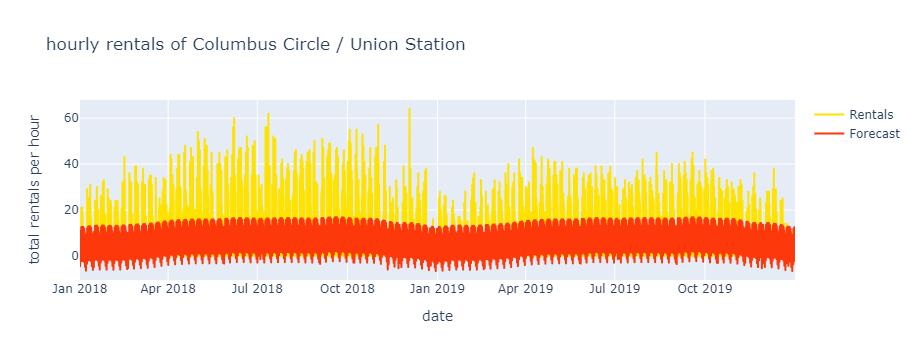

In [37]:
fig = px.line(
    x=test_data['ds'], y=[test_data.y, fcast['2018':]['yhat']],
    color_discrete_sequence=colors, labels={"variable":""},
    title='hourly rentals of Columbus Circle / Union Station'
)

newnames= {
    "wide_variable_0": "Rentals",
    "wide_variable_1": "Forecast"
}
fig.for_each_trace(lambda t: t.update(name = newnames[t.name],
                                      legendgroup = newnames[t.name],
                                      hovertemplate = t.hovertemplate.replace(t.name, newnames[t.name])))
fig.update_xaxes(title_text='date')
fig.update_yaxes(title_text='total rentals per hour')
fig.show()

### Trying other models on the data
#### Weather data should be added before that and also the holidays of Washington DC

In [38]:
# !pip install meteostat

In [39]:
import holidays
from meteostat import Hourly, Stations

In [40]:
outgoings.index.year.unique().to_list()

[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019]

In [41]:
all_holidays = holidays.country_holidays('US', subdiv='DC', years=outgoings.index.year.unique().to_list())

In [42]:
import datetime

#### combining weather data and holidays

In [43]:
# map not working pandas datetime.normalize() or datetime.date
# need to use slow DataFrame.all()
def get_holiday(row):
    # '2014-01-01'
    date = str(row.Start_date.year) + '-' + str(row.Start_date.month).zfill(2) + '-' + str(row.Start_date.day).zfill(2)
    row['holiday_name'] = all_holidays.get(date, 'No-Holiday')
    return row

outgoings = outgoings.reset_index().apply(get_holiday, axis=1)

In [44]:
# stations = Stations()
# stations = stations.nearby(lat, lon)
# station = stations.fetch(1)

# # Print DataFrame
# station

In [45]:
# Get hourly data
station_id = '72405'
start = datetime.datetime(2010, 1, 1)
end_date = datetime.datetime(2020, 12, 31, 23, 59)
weather_data = Hourly(station_id, start, end_date)
weather_data = weather_data.fetch()

In [46]:
weather_data.head(2)

,temp,dwpt,rhum,prcp,snow,wdir,wspd,wpgt,pres,tsun,coco
time,,,,,,,,,,,
2010-01-01 00:00:00,2.2,-0.1,85.0,NaN,NaN,240.0,9.4,NaN,1018.7,NaN,NaN
2010-01-01 01:00:00,2.2,-0.1,85.0,0.8,NaN,NaN,0.0,NaN,1018.2,NaN,NaN


In [47]:
outgoings = outgoings.set_index('Start_date', drop=True)

In [48]:
outgoings.head(2)

,rentals_in_hour,holiday_name
Start_date,,
2010-10-26 11:00:00,1,No-Holiday
2010-10-26 12:00:00,0,No-Holiday


In [49]:
weather_cols = {
    'dwpt': 'dew_point', 'rhum': 'rel_humidity', 'prcp': 'precipitation',
    'tsun': 'sun_minutes'
}
weather_data.rename(columns=weather_cols, inplace=True)
weather_data = weather_data.drop(['pres', 'coco'], axis=1)

In [50]:
weather_data.tail(2)

,temp,dew_point,rel_humidity,precipitation,snow,wdir,wspd,wpgt,sun_minutes
time,,,,,,,,,
2019-12-31 22:00:00,11.1,-1.0,43.0,0.0,NaN,220.0,16.6,NaN,NaN
2019-12-31 23:00:00,10.6,-1.2,44.0,0.0,NaN,220.0,11.2,NaN,NaN


In [51]:
weather_data.fillna(method='ffill', inplace=True)

In [52]:
outgoings.fillna(method='bfill', inplace=True)

In [53]:
outgoings = outgoings.merge(weather_data, how='left', left_index=True, right_index=True)

In [54]:
# outgoings = pd.get_dummies(outgoings.holiday_name, drop_first=True)
# outgoings = pd.get_dummies(outgoings, columns=['holiday_name'], drop_first=True)
outgoings['is_holiday'] = np.where(outgoings.holiday_name == 'No-Holiday', 0, 1)

In [55]:
outgoings.columns

Index(['rentals_in_hour', 'holiday_name', 'temp', 'dew_point', 'rel_humidity',
       'precipitation', 'snow', 'wdir', 'wspd', 'wpgt', 'sun_minutes',
       'is_holiday'],
      dtype='object')

### Checking for relation with the weather variables

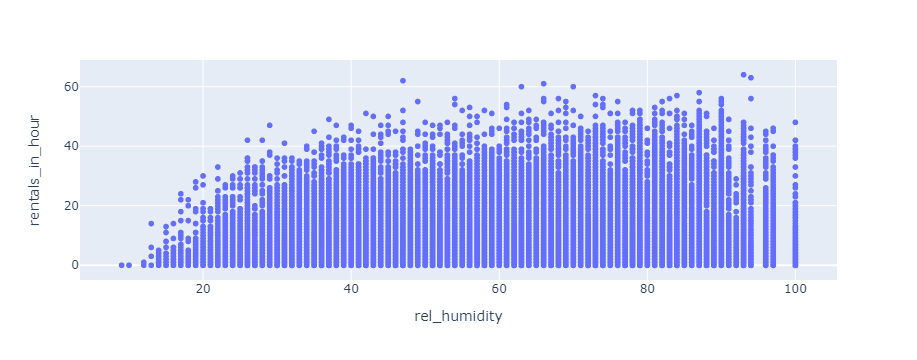

In [56]:
# 'dwpt': 'dew_point', 'rhum': 'rel_humidity', 'prcp': 'precipitation',
# 'tsun': 'sun_minutes'
# outgoings.rename(columns=weather_cols, inplace=True)
px.scatter(outgoings, x='rel_humidity', y='rentals_in_hour')

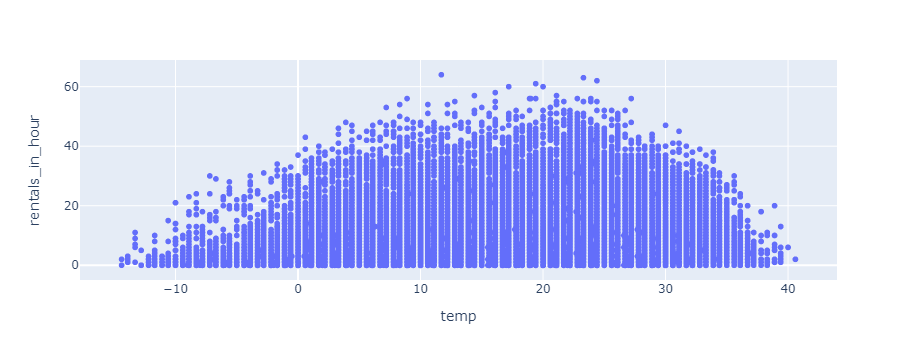

In [57]:
px.scatter(outgoings, x='temp', y='rentals_in_hour')

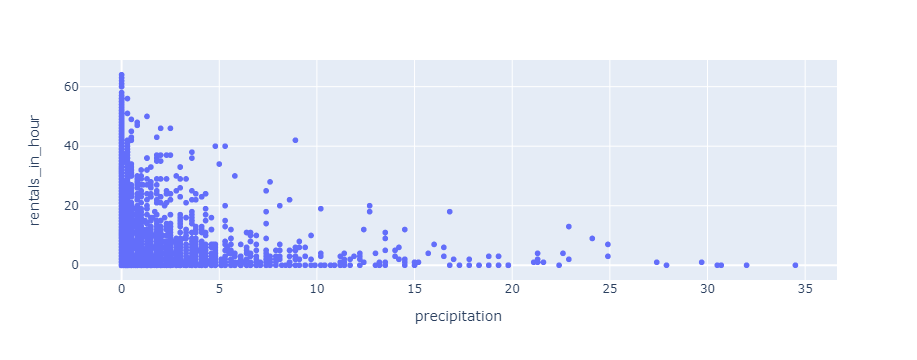

In [58]:
px.scatter(outgoings, x='precipitation', y='rentals_in_hour')

### Further feature engineering

In [59]:
# get the coulmn for weekend
outgoings.index.weekday.unique().to_list()
outgoings['work_day'] = np.where(outgoings.index.weekday.isin([0, 1, 2, 3, 4]), 1, 0)

In [60]:
months_order = outgoings.groupby(outgoings.index.month, as_index=True)[['rentals_in_hour']].sum().sort_values(
    by='rentals_in_hour', ascending=False
).index
months_order

Int64Index([8, 6, 7, 9, 10, 5, 4, 11, 3, 12, 2, 1], dtype='int64')

In [61]:
month_ranks = {}
for rank, month in enumerate(months_order):
    month_ranks[month] = rank + 1
    
month_ranks

{8: 1, 6: 2, 7: 3, 9: 4, 10: 5, 5: 6, 4: 7, 11: 8, 3: 9, 12: 10, 2: 11, 1: 12}

In [62]:
outgoings['month_rank'] = outgoings.index.month.map(month_ranks)

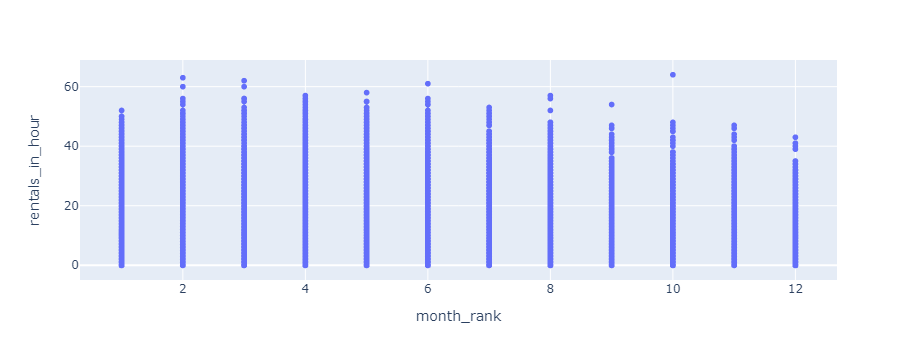

In [63]:
px.scatter(outgoings, x='month_rank', y='rentals_in_hour')

In [64]:
# adding hour of day rank as feature
hours_order = outgoings.groupby(outgoings.index.hour, as_index=True)[['rentals_in_hour']].sum().sort_values(
    by='rentals_in_hour', ascending=False
).index
hour_ranks = {}
for rank, hour in enumerate(hours_order):
    hour_ranks[hour] = rank + 1
    
print(hour_ranks)

{8: 1, 17: 2, 7: 3, 18: 4, 16: 5, 6: 6, 9: 7, 19: 8, 15: 9, 12: 10, 13: 11, 14: 12, 20: 13, 11: 14, 10: 15, 21: 16, 22: 17, 23: 18, 5: 19, 0: 20, 1: 21, 2: 22, 3: 23, 4: 24}


In [65]:
outgoings['hour_rank'] = outgoings.index.hour.map(hour_ranks)

In [66]:
# adding year too
outgoings['year'] = outgoings.index.year

In [67]:
outgoings.head(2)

,rentals_in_hour,holiday_name,temp,dew_point,rel_humidity,precipitation,snow,wdir,wspd,wpgt,sun_minutes,is_holiday,work_day,month_rank,hour_rank,year
2010-10-26 11:00:00,1,No-Holiday,18.0,16.0,88.0,0.0,NaN,180.0,11.2,NaN,NaN,0,1,5,14,2010
2010-10-26 12:00:00,0,No-Holiday,17.8,16.1,90.0,0.0,NaN,180.0,11.2,NaN,NaN,0,1,5,10,2010


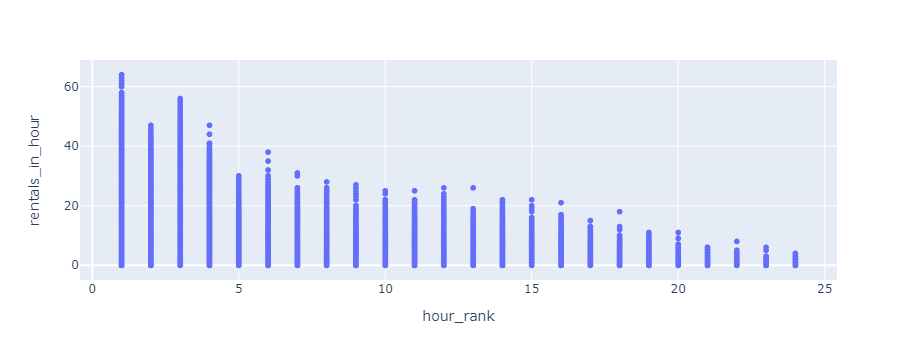

In [68]:
px.scatter(outgoings, x='hour_rank', y='rentals_in_hour')

In [69]:
outgoings.fillna(method='bfill', inplace=True)

### Testing different models

In [70]:
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.neural_network import MLPRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn.linear_model import LinearRegression

In [72]:
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error

In [73]:
outgoings.fillna(0, inplace=True)

In [74]:
# splitting in train and test set
X, y = outgoings.drop(['rentals_in_hour', 'holiday_name', 'dew_point'], axis=1), outgoings['rentals_in_hour']
X_train, X_test = X[:'2017'], X['2018':]
y_train, y_test = y[:'2017'], y['2018':]

In [75]:
lin_reg_pipe = Pipeline(
    [
        ('scaler', StandardScaler()),
        ('mlp_regressor', LinearRegression())
    ]
)
lin_reg_pipe.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('mlp_regressor', LinearRegression())])

In [76]:
preds = lin_reg_pipe.predict(X_test)
mean_squared_error(y_true=y_test, y_pred=preds, squared=False)

6.4779538716324

In [77]:
mlp_reg_pipe = Pipeline(
    [
        ('scaler', StandardScaler()),
        ('mlp_regressor', MLPRegressor(random_state=1, max_iter=500))
    ]
)
mlp_reg_pipe.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('mlp_regressor', MLPRegressor(max_iter=500, random_state=1))])

In [78]:
mlp_preds = mlp_reg_pipe.predict(X_test)
# mlp_reg_pipe.score(X_test, y_test)

In [79]:
# y_test['mlp_preds'] = preds
mean_squared_error(y_true=y_test, y_pred=mlp_preds, squared=False)

4.286864977428928

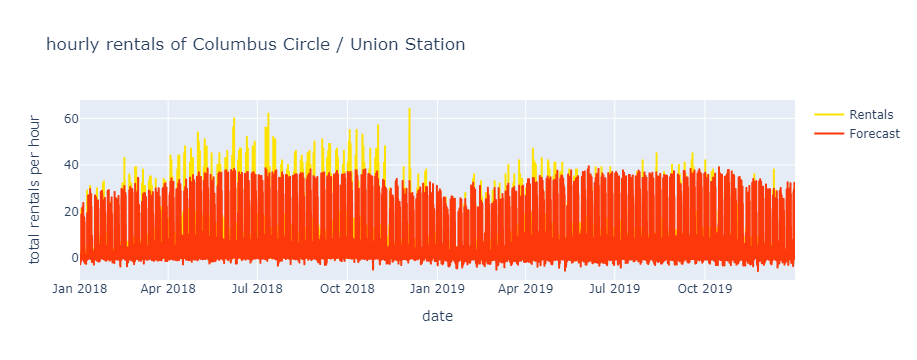

In [80]:
fig = px.line(
    x=y_test.index, y=[y_test, mlp_preds],
    color_discrete_sequence=colors, labels={"variable":""},
    title='hourly rentals of Columbus Circle / Union Station'
)

newnames= {
    "wide_variable_0": "Rentals",
    "wide_variable_1": "Forecast"
}
fig.for_each_trace(lambda t: t.update(name = newnames[t.name],
                                      legendgroup = newnames[t.name],
                                      hovertemplate = t.hovertemplate.replace(t.name, newnames[t.name])))
fig.update_xaxes(title_text='date')
fig.update_yaxes(title_text='total rentals per hour')
fig.show()

In [81]:
ridge_reg_pipe = Pipeline(
    [
        ('scaler', StandardScaler()),
        ('ridge_regression', Ridge(alpha=0.5))
    ]
)
ridge_reg_pipe.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('ridge_regression', Ridge(alpha=0.5))])

In [82]:
ridge_preds = ridge_reg_pipe.predict(X_test)
mean_squared_error(y_true=y_test, y_pred=ridge_preds, squared=False)

6.477949943113407

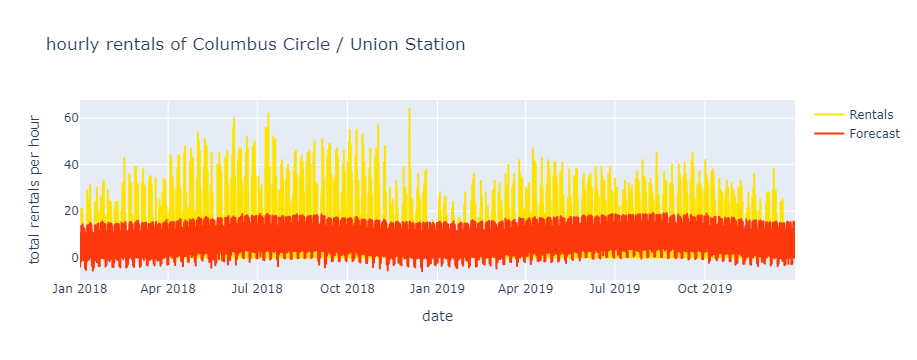

In [83]:
fig = px.line(
    x=y_test.index, y=[y_test, ridge_preds],
    color_discrete_sequence=colors, labels={"variable":""},
    title='hourly rentals of Columbus Circle / Union Station'
)

newnames= {
    "wide_variable_0": "Rentals",
    "wide_variable_1": "Forecast"
}
fig.for_each_trace(lambda t: t.update(name = newnames[t.name],
                                      legendgroup = newnames[t.name],
                                      hovertemplate = t.hovertemplate.replace(t.name, newnames[t.name])))
fig.update_xaxes(title_text='date')
fig.update_yaxes(title_text='total rentals per hour')
fig.show()

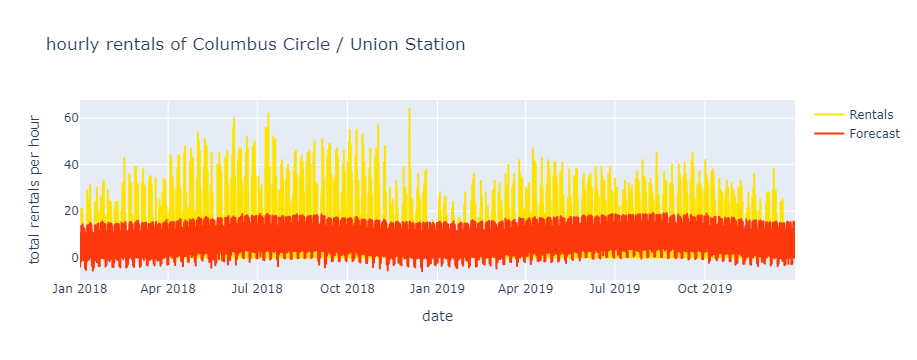

In [84]:
fig = px.line(
    x=y_test.index, y=[y_test, ridge_preds],
    color_discrete_sequence=colors, labels={"variable":""},
    title='hourly rentals of Columbus Circle / Union Station'
)

newnames= {
    "wide_variable_0": "Rentals",
    "wide_variable_1": "Forecast"
}
fig.for_each_trace(lambda t: t.update(name = newnames[t.name],
                                      legendgroup = newnames[t.name],
                                      hovertemplate = t.hovertemplate.replace(t.name, newnames[t.name])))
fig.update_xaxes(title_text='date')
fig.update_yaxes(title_text='total rentals per hour')
fig.show()

In [85]:
from sklearn.ensemble import HistGradientBoostingRegressor

In [86]:
print(dir())

['HistGradientBoostingRegressor', 'Hourly', 'In', 'KernelRidge', 'LinearRegression', 'MLPRegressor', 'Out', 'Pipeline', 'Prophet', 'Ridge', 'StandardScaler', 'Stations', 'X', 'X_test', 'X_train', '_', '_12', '_17', '_2', '_22', '_23', '_26', '_27', '_31', '_32', '_33', '_40', '_46', '_48', '_5', '_50', '_55', '_56', '_57', '_58', '_60', '_61', '_63', '_67', '_68', '_7', '_75', '_76', '_77', '_79', '_81', '_82', '_9', '__', '___', '__builtin__', '__builtins__', '__doc__', '__loader__', '__name__', '__package__', '__spec__', '_dh', '_i', '_i1', '_i10', '_i11', '_i12', '_i13', '_i14', '_i15', '_i16', '_i17', '_i18', '_i19', '_i2', '_i20', '_i21', '_i22', '_i23', '_i24', '_i25', '_i26', '_i27', '_i28', '_i29', '_i3', '_i30', '_i31', '_i32', '_i33', '_i34', '_i35', '_i36', '_i37', '_i38', '_i39', '_i4', '_i40', '_i41', '_i42', '_i43', '_i44', '_i45', '_i46', '_i47', '_i48', '_i49', '_i5', '_i50', '_i51', '_i52', '_i53', '_i54', '_i55', '_i56', '_i57', '_i58', '_i59', '_i6', '_i60', '_i61', 

In [87]:
del Hourly
del KernelRidge
del LinearRegression
del Ridge
del Stations
del all_holidays
del datetime
del end_date
del start
del holidays
del hour
del hour_ranks
del hours_order
del preds
del rank
del ridge_preds
del ridge_reg_pipe
del union_station
del weather_cols
del weather_data
del lin_reg_pipe

In [88]:
gbr_pipe = Pipeline(
    [
        ('scaler', StandardScaler()),
        ('hist_gbr', HistGradientBoostingRegressor(learning_rate=0.3, max_iter=300, l2_regularization=0.3,
                                                  random_state=42))
    ]
)
gbr_pipe.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('hist_gbr',
                 HistGradientBoostingRegressor(l2_regularization=0.3,
                                               learning_rate=0.3, max_iter=300,
                                               random_state=42))])

In [89]:
gbr_preds = gbr_pipe.predict(X_test)

In [90]:
mean_squared_error(y_true=y_test, y_pred=gbr_preds, squared=False)

4.169652283708863

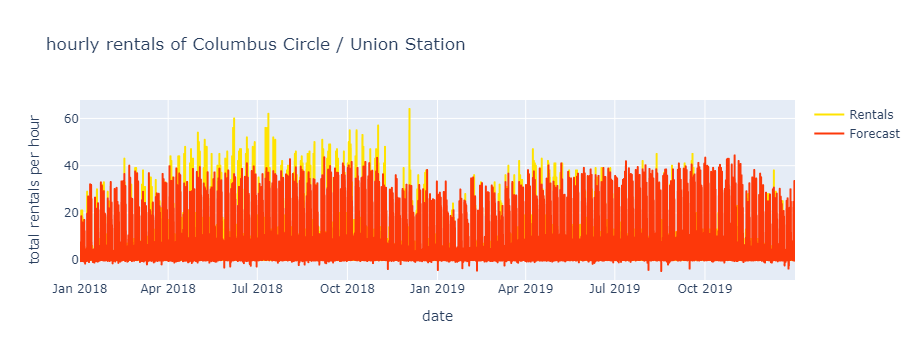

In [91]:
fig = px.line(x=y_test.index, y=[y_test, gbr_preds],
              color_discrete_sequence=colors, labels={"variable":""},
              title='hourly rentals of Columbus Circle / Union Station'
             )
newnames= {
    "wide_variable_0": "Rentals",
    "wide_variable_1": "Forecast"
}
fig.for_each_trace(lambda t: t.update(name = newnames[t.name],
                                      legendgroup = newnames[t.name],
                                      hovertemplate = t.hovertemplate.replace(t.name, newnames[t.name])))
fig.update_xaxes(title_text='date')
fig.update_yaxes(title_text='total rentals per hour')
fig.show()

In [92]:
mlp_reg_pipe_2 = Pipeline(
    [
        ('scaler', StandardScaler()),
        ('mlp_regressor', MLPRegressor(random_state=1, max_iter=700, alpha=0.00001,
                                      early_stopping=False))
    ]
)
mlp_reg_pipe_2.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('mlp_regressor',
                 MLPRegressor(alpha=1e-05, max_iter=700, random_state=1))])

In [93]:
mlp_2_preds = mlp_reg_pipe_2.predict(X_test)

In [94]:
mean_squared_error(y_true=y_test, y_pred=mlp_2_preds, squared=False)

4.347489084134689

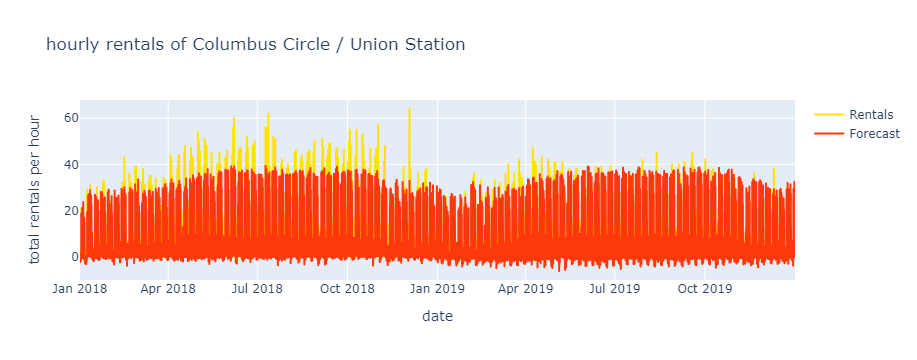

In [95]:
fig = px.line(
    x=y_test.index, y=[y_test, mlp_2_preds],
    color_discrete_sequence=colors, labels={"variable":""},
    title='hourly rentals of Columbus Circle / Union Station'
)
newnames= {
    "wide_variable_0": "Rentals",
    "wide_variable_1": "Forecast"
}
fig.for_each_trace(lambda t: t.update(name = newnames[t.name],
                                      legendgroup = newnames[t.name],
                                      hovertemplate = t.hovertemplate.replace(t.name, newnames[t.name])))
fig.update_xaxes(title_text='date')
fig.update_yaxes(title_text='total rentals per hour')
fig.show()

In [101]:
round(3.0003233, 3)

3.0